# Examining the Relationship Between Music VAE's Latent Space and Feature Space

In [1]:
# make tensorflow stop yelling all the time
import tensorflow.logging
from logging import ERROR
tensorflow.logging.set_verbosity(ERROR)

import numpy as np, seaborn as sns, matplotlib.pyplot as plt, scipy as sp
import scipy.spatial.distance as distance
from magenta import music as mm # midi manipulation etc.
import itertools, functools
from IPython.display import Audio

# force reloading of our own libraries
import importlib
import magenta.models.music_vae.music_vae_decode as mvd
importlib.reload(mvd);

The history saving thread hit an unexpected error (DatabaseError('database disk image is malformed')).History will not be written to the database.

For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
If you depend on functionality not listed there, please file an issue.



## Preparing a Dataset

MusicVAE generates music by randomly generating latent spaces from the standard normal distribution. However, if you're interested in looking at latent spaces that are close to each other, randomly generating each independently is not a good strategy. That yields low likelihood of having nearby latent spaces. 

Instead, this strategy randomly creates one latent space, then creates the next latent space by randomly adding and subtracting noise from the original latent space. This process continues iteratively, and on each step there is a small random chance that a new random latent space will be generated, independent of prior latent spaces.

In [2]:
def make_z(n, z_size=512, restart_prob=.01, jitter=.1):
    '''
    Generates latent spaces. Attempts to create a mixture of close and far latent spaces.
    
    n: number of latent spaces desired
    z_size: dimension of latent space
    restart_prob: the probability that a new latent space will be created independently of the existing latent spaces. Increasing this makes less latent spaces that are near each other and vice versa.
    jitter: the scale of the gaussian that creates the noise modifying successive latent spaces
    
    returns: latent spaces in an nd.array of shape (n, z_size)
    '''
    z = np.zeros((n, z_size))
    z[0] = np.random.randn(z_size) # start with a random latent space
    for i in range(1, len(z)):
        # add random noise to the last latent space
        z[i] = z[i - 1] + np.random.normal(scale=jitter, size=512)
        
        # sometimes just make an entirely new one up
        if np.random.rand() < restart_prob:
            z[i] = np.random.randn(z_size)
            
    return z

We also need to calculate some features on the MIDI.

In [3]:
def n_onsets(m):
    '''
    Returns the total number of onsets occuring in m. 
    
    m: pretty_midi object
    '''
    return len(m.get_onsets())

def pitch_hist(m):
    '''
    Returns the pitch histogram for m. 
    
    m: pretty_midi object
    '''
    return m.get_pitch_class_histogram()

def onsets(m):
    '''
    Returns the onset events in a many-hot encoding.
    
    m: pretty_midi object
    '''
    l = 64
    onset_times = m.get_onsets() * l / m.get_end_time()
    onset_times = np.around(onset_times).astype(int)
    onsets = np.zeros(l)
    onsets[onset_times] = 1
    return onsets

def is_in_c(m):
    '''
    Evaluates the overlap between the pitch class histogram for m and the same for the key of C. 
    
    m: pretty_midi object
    '''
    pitch_hist = m.get_pitch_class_histogram()
    C = [1, 0, 1, 0, 1, 1, 0, 1, 0, 1, 0, 1]
    return distance.euclidean(pitch_hist, C)

def pitch_range(m):
    '''
    Returns the difference between the greatest and smallest pitches in m
    
    m: pretty_midi object
    '''
    pr = m.get_piano_roll() > 0 # get binarized piano roll (128, t)
    return len(np.trim_zeros(pr.sum(axis=1)))

Now we'll create a decoder, and turn our latent spaces into MIDI (we'll calculate the features later).

In [4]:
model_path = "./models/cat-mel_2bar_big.tar"
config_name = "cat-mel_2bar_big"
n = 20000
z_size = 512

decoder = mvd.VAEDecoder(model_path, config_name, "./output/music_vae", max_batch_size=256)
z = make_z(n, z_size, restart_prob=.005, jitter=.05)
sequences = decoder.decode(z)
midi = np.array([mm.sequence_proto_to_pretty_midi(seq) for seq in sequences])

## Evaluation

We now have pairs of latent spaces and MIDI that we can calculate features from. We need a way to evaluate how correlated these two surfaces are.

One thing we can try is to select random pairs and compare their distance in the latent space to their distance in the feature space. Here, we'll try it using several features and several distance measures.

In [5]:
def scatter(z, midi, dist, feat, i, r, c, n_samples=10000):
    ax = plt.subplot(r, c, i + 1)
    
    samples = np.random.randint(0, high=len(midi), size=n_samples * 2)
    samples = samples.reshape(2, n_samples)
    
    z_pairs = zip(z[samples[0]], z[samples[1]])
    l_dist = np.array([dist(a, b) for a, b in z_pairs])

    midi_pairs = zip(midi[samples[0]], midi[samples[1]])    
    m_dist = np.array([dist(feat(a), feat(b)) for a, b in midi_pairs])
    
    # filter out nan values
    i = ~np.isnan(l_dist) & ~np.isnan(m_dist)
    l_dist = l_dist[i]
    m_dist = m_dist[i]
    
    ax.scatter(l_dist, m_dist, s=2)
    ax.set_title("{0} - {1}".format(feat.__name__, dist.__name__))
    ax.set_xlabel("latent space ({0})".format(dist.__name__))
    ax.set_ylabel("{0} ({1})".format(feat.__name__, dist.__name__))
    
    # linear regression
    m, b, r, _, _ = sp.stats.linregress(l_dist, m_dist)
    x = np.linspace(min(l_dist), max(l_dist), num=200)
    y = m*x + b
    ax.plot(x, y, c='r', label='y = {:.2f}x + {:.2f} , R^2 = {:.2f}'.format(m, b, r ** 2))
    ax.legend()

/home/brian/anaconda3/envs/magenta/lib/python3.7/site-packages/scipy/spatial/distance.py:702: RuntimeWarning: invalid value encountered in double_scalars
  dist = 1.0 - uv / np.sqrt(uu * vv)


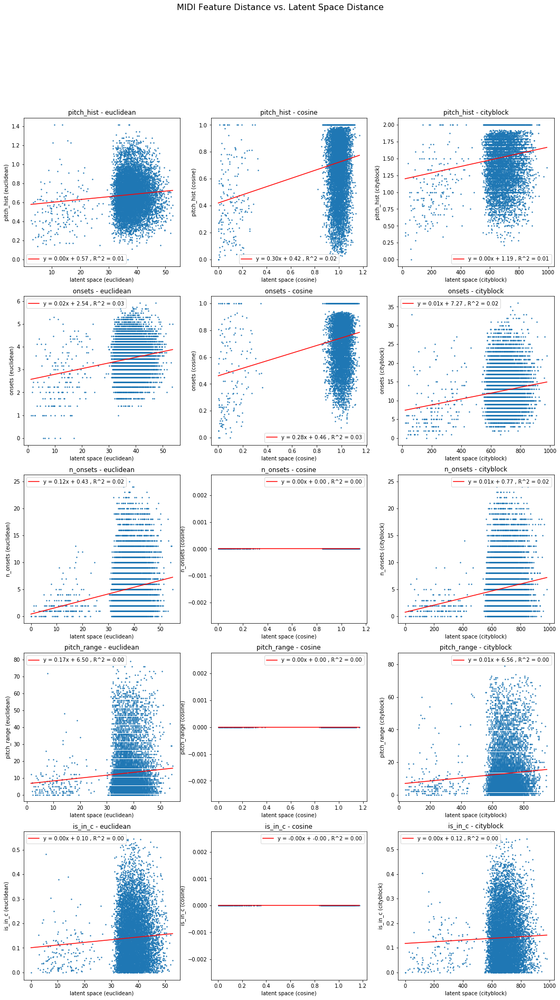

In [6]:
dist_measures = [distance.euclidean, distance.cosine, distance.cityblock]
midi_features = [pitch_hist, onsets, n_onsets, pitch_range, is_in_c]

fig = plt.figure(figsize=(18,30))
fig.suptitle("MIDI Feature Distance vs. Latent Space Distance", fontsize=16)
c = len(dist_measures)
r = len(midi_features)
n = r * c
for i, (feat, dist) in enumerate(itertools.product(midi_features, dist_measures)):
        scatter(z, midi, dist, feat, i, r, c, n_samples=10000)

No clear relationship emerges, but something is clear in regards to the pitch_hist feature - latent space distance is bimodal. There is a sparse section with low distance and then a denser section with high distance. The separation between these two clusters is most apparent when using cosine distance, but is visible with all distance measures evaluated here.

Conveniently, we have reason to believe that we can safely ignore the high distance cluster. We're aiming to answer the question "are these two spaces locally correlated" - we don't need to prove that they're also non-locally uncorrelated. In other words, we can just focus on small deviations in the latent space to evaluate whether there is a correlation to the feature space.

A good first step would be to manually chop values off above a certain level and then re-try the linear fit.

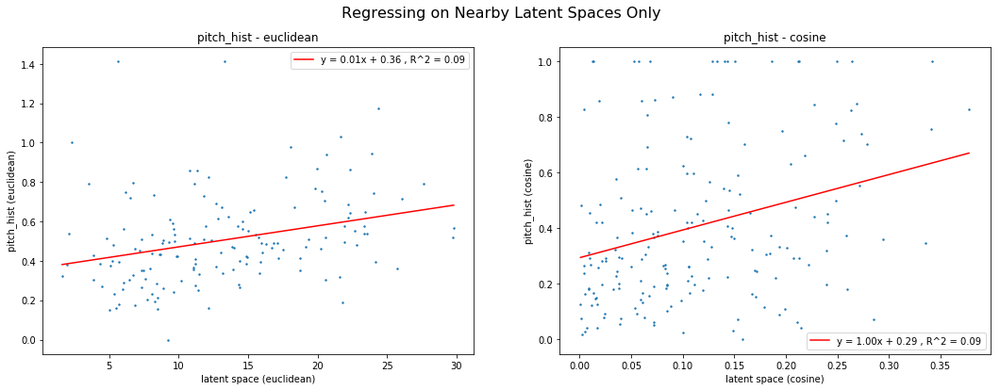

In [7]:
def scatter_with_cutoff(z, midi, dist, feat, i, r, c, cutoff, n_samples=10000):
    ax = plt.subplot(r, c, i + 1)
    samples = np.random.randint(0, high=len(midi), size=n_samples * 2)
    samples = samples.reshape(2, n_samples)

    z_pairs = zip(z[samples[0]], z[samples[1]])
    l_dist = np.array([dist(a, b) for a, b in z_pairs])

    midi_pairs = zip(midi[samples[0]], midi[samples[1]])    
    m_dist = np.array([dist(feat(a), feat(b)) for a, b in midi_pairs])

    # chop values off above the cutoff
    i = l_dist < cutoff 
    l_dist = l_dist[i]
    m_dist = m_dist[i]

    i = ~np.isnan(l_dist) & ~np.isnan(m_dist)
    l_dist = l_dist[i]
    m_dist = m_dist[i]

    ax.scatter(l_dist, m_dist, s=2)
    ax.set_title("{0} - {1}".format(feat.__name__, dist.__name__))
    ax.set_xlabel("latent space ({0})".format(dist.__name__))
    ax.set_ylabel("{0} ({1})".format(feat.__name__, dist.__name__))
    
    # linear regression
    m, b, r, _, _ = sp.stats.linregress(l_dist, m_dist)
    x = np.linspace(min(l_dist), max(l_dist), num=200)
    y = m*x + b
    ax.plot(x, y, c='r', label='y = {:.2f}x + {:.2f} , R^2 = {:.2f}'.format(m, b, r ** 2))
    ax.legend()
    
    
fig = plt.figure(figsize=(18,6))
fig.suptitle("Regressing on Nearby Latent Spaces Only", fontsize=16)

cutoff = 30
scatter_with_cutoff(z, midi, distance.euclidean, pitch_hist, 0, 1, 2, cutoff)

cutoff = .55
scatter_with_cutoff(z, midi, distance.cosine, pitch_hist, 1, 1, 2, cutoff)

## "Prototypical" Latent Spaces

Here, we attempt to figure out prototypical latent spaces for features. We do this by averaging sets of latent spaces of both the most and least extreme examples for a given feature.

In [8]:
def prototypical_z(z, midi, feat, percentile=10):
    features = [feat(m) for m in midi]

    bottom = np.percentile(features, percentile)
    top = np.percentile(features, 100 - percentile)
    
    low_z = z[features < bottom].mean(axis=0)
    high_z = z[features > top].mean(axis=0)

    fig = plt.figure(figsize=(16,6))
    fig.suptitle("Extreme {0}% of {1}".format(percentile, feat.__name__), fontsize=16)
    
    ax = plt.subplot(2, 3, 1)
    ax.set_title("{0} < {1:.2f}".format(feat.__name__, bottom))
    ax.axis("off")
    ax.matshow(low_z.reshape(16, 32))
    
    
    ax = plt.subplot(2, 3, 2)
    ax.set_title("{0} > {1:.2f}".format(feat.__name__, top))
    ax.axis("off")
    ax.matshow(high_z.reshape(16, 32))


    ax = plt.subplot(2, 3, 3)
    ax.set_title("diff".format(feat.__name__, top))
    ax.axis("off")
    ax.matshow((high_z - low_z).reshape(16, 32))

    
    ax = plt.subplot(2, 3, 4)
    ax.hist(abs(low_z), bins=50)
    ax = plt.subplot(2, 3, 5)
    ax.hist(abs(high_z), bins=50);    
    ax = plt.subplot(2, 3, 6)
    ax.hist(abs(high_z-low_z), bins=50);    
    
    return low_z, high_z

Let's visualize the latent spaces of the top and bottom 10% of the dataset in terms of number of onsets (i.e. note density). The top row is a direct visualization of the latent space*, and the bottom row is a histogram of the magnitudes of node activations in the latent space. We would hope to see a few nodes with very strong activations and the remainder with weaker activations.


*Note: the shape is totally arbitrary, and therefore so spatial patterns on it are likely meaningless

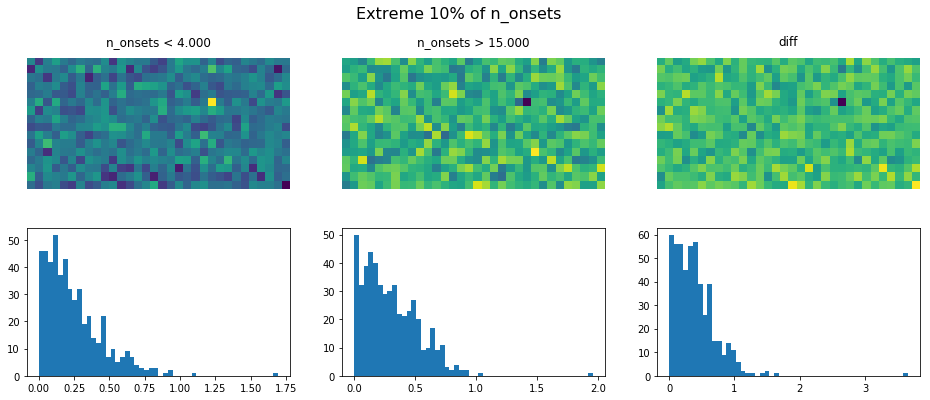

In [9]:
low_z, high_z = prototypical_z(z, midi, n_onsets, 10)

Let's decode the prototypical high onset and low onset latent spaces and examine further.

In [10]:
low_onset = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(low_z.reshape(1, z_size))][0]
high_onset = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(high_z.reshape(1, z_size))][0]

In [11]:
print("# of onsets (should be low): {0}".format(n_onsets(low_onset)))
Audio(low_onset.synthesize(), rate=44100)

# of onsets (should be low): 1


In [12]:
print("# of onsets (should be high): {0}".format(n_onsets(high_onset)))
Audio(high_onset.synthesize(), rate=44100)

# of onsets (should be high): 18


That looks right, but we can dig deeper. Instead of just decoding the prototypical latent spaces, let's hold the "important" (high difference in activation between the two prototypes) nodes constant and set the "un-important" (low difference in activation) nodes to noise.

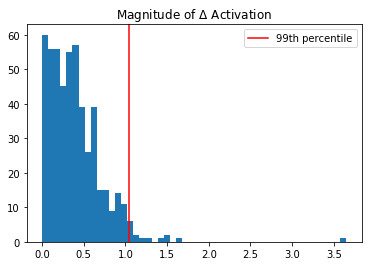

In [13]:
diff_z = high_z - low_z
plt.hist(abs(diff_z), bins=50)
plt.title("Magnitude of $\Delta$ Activation")
plt.axvline(np.percentile(diff_z, 99), c='r', label="99th percentile")
plt.legend();

In [14]:
unimportant_nodes = abs(diff_z) < np.percentile(diff_z, 99)
print("{0} of {1} nodes have been deemed unimportant".format(sum(unimportant_nodes), len(diff_z)))

new_low_z = np.copy(low_z)
new_high_z = np.copy(high_z)

new_low_z[unimportant_nodes] = np.random.randn(sum(unimportant_nodes))
new_high_z[unimportant_nodes] = np.random.randn(sum(unimportant_nodes))

new_low_onset = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(new_low_z.reshape(1, z_size))][0]
new_high_onset = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(new_high_z.reshape(1, z_size))][0]

498 of 512 nodes have been deemed unimportant


In [15]:
print("# of Onsets (should be low): {0}".format(n_onsets(new_low_onset)))
Audio(new_low_onset.synthesize(), rate=44100)

# of Onsets (should be low): 4


In [16]:
print("# of Onsets (should be high): {0}".format(n_onsets(new_high_onset)))
Audio(new_high_onset.synthesize(), rate=44100)

# of Onsets (should be high): 18


That looks good, too. Let's confirm these results by calculating many latent spaces in this way and evaluating the number of onsets.

In [17]:
n_samples = 2000

low_zs = np.tile(low_z, (n_samples, 1))
high_zs = np.tile(high_z, (n_samples, 1))

low_zs[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))
high_zs[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))

low_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(low_zs)]
high_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(high_zs)]

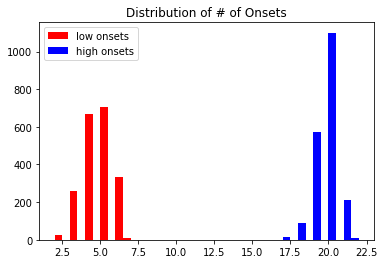

In [18]:
plt.hist([n_onsets(m) for m in low_onsets], color='r', label="low onsets")
plt.hist([n_onsets(m) for m in high_onsets], color='b', label="high onsets")
plt.title("Distribution of # of Onsets")
plt.legend();

Now we've established that we can identify the important and unimportant nodes for this feature at its extremes, let's see if we can take the idea further and reason about the space in between the extremes.

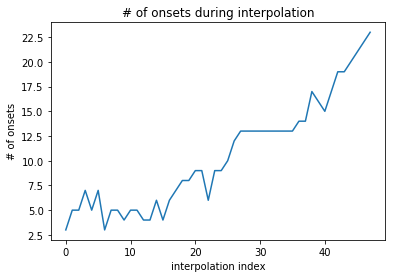

In [44]:
n_samples = 48 # 96 bars

# interpolate from low_z to high_z
interpolated = np.zeros((n_samples, z_size))
for i in range(n_samples):
    mixing_ratio = (i + 1) / n_samples
    interpolated[i, :] = (1 - mixing_ratio) * low_z + mixing_ratio * high_z

# set the unimportant nodes to noise
interpolated[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))

interpolated_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(interpolated)]
audio = np.concatenate([m.synthesize() for m in interpolated_onsets])
plt.plot([n_onsets(m) for m in interpolated_onsets])
plt.title("# of onsets during interpolation")
plt.xlabel("interpolation index")
plt.ylabel("# of onsets")
Audio(audio, rate=44100)

## Feature-Agnostic "Prototypical" Latent Spaces

Here, we attempt to figure out prototypical latent spaces for features. We do this by averaging sets of latent spaces of both the most and least extreme examples for a given feature.

In [56]:
def feature_interpolation(z, midi, feat, percentile=10, plot=True):
    # calculate the prototypes and determine which nodes are important
    features = [feat(m) for m in midi]
    bottom = np.percentile(features, percentile)
    top = np.percentile(features, 100 - percentile)
    
    low_z = z[features < bottom].mean(axis=0)
    high_z = z[features > top].mean(axis=0)
    diff_z = high_z - low_z
    unimportant_nodes = abs(diff_z) < np.percentile(diff_z, 99)

    # make a bunch of prototypical high and low latent spaces with unimportant nodes set to random noise
    n_samples = 500
    low_zs = np.tile(low_z, (n_samples, 1))
    high_zs = np.tile(high_z, (n_samples, 1))
    low_zs[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))
    high_zs[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))
    low_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(low_zs)]
    high_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(high_zs)]

    # interpolate from the prototypical low and high latent spaces with unimportant nodes set to random noise
    n_samples = 48 # 96 bars
    interpolated = np.zeros((n_samples, z_size))
    for i in range(n_samples):
        mixing_ratio = (i + 1) / n_samples
        interpolated[i, :] = (1 - mixing_ratio) * low_z + mixing_ratio * high_z
    interpolated[:, unimportant_nodes] = np.random.randn(sum(unimportant_nodes))
    interpolated_onsets = [mm.sequence_proto_to_pretty_midi(seq) for seq in decoder.decode(interpolated)]
    
    if plot:
        fig = plt.figure(figsize=(16, 6))
        fig.suptitle("Prototype of {0}".format(feat.__name__), fontsize=16)

        ax = plt.subplot(1, 3, 1)
        ax.hist(abs(diff_z), bins=50)
        ax.set_title("Magnitude of $\Delta$ Activation")
        ax.axvline(np.percentile(diff_z, 99), c='r', label="99th percentile")
        ax.legend()

        ax = plt.subplot(1, 3, 2)
        ax.hist([feat(m) for m in low_onsets], color='r', label="low onsets")
        ax.hist([feat(m) for m in high_onsets], color='b', label="high onsets")
        ax.set_title("Feature Distribution on Extreme Prototypes")
        ax.set_xlabel(feat.__name__)
        ax.legend() 
        
        ax = plt.subplot(1, 3, 3)
        ax.plot([feat(m) for m in interpolated_onsets])
        ax.set_title("Feature Distribution During Interpolation")
        ax.set_xlabel("interpolation index")
        ax.set_ylabel(feat.__name__)
        
    return low_z, high_z

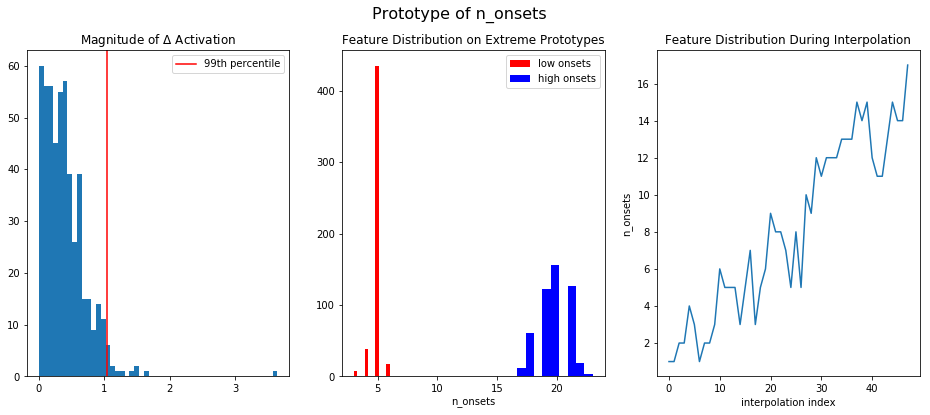

In [57]:
low_z, high_z = feature_interpolation(z, midi, n_onsets)

In [ ]:
low_z, high_z = feature_interpolation(z, midi, is_in_c)

In [ ]:
low_z, high_z = feature_interpolation(z, midi, pitch_range)